-----------
# <center> U-NET CODE </center>
-----------

---
### IMPORT LIBRARIES
---

In [2]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
from tensorflow import keras
from tensorflow.keras import layers
import time

import os
GLOBAL_SEED = 2147483648
np.random.seed(GLOBAL_SEED)
tf.random.set_seed(GLOBAL_SEED)

2023-04-06 11:47:43.333983: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-06 11:47:44.625764: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-04-06 11:47:57.549105: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /glade/u/apps/dav/opt/cuda/11.4.0/extras/CUPTI/lib64:/glade/u/apps/dav/opt/cuda/11.4.0/

Num GPUs Available:  0


2023-04-06 11:48:12.533636: E tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:267] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2023-04-06 11:48:12.534381: I tensorflow/compiler/xla/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (crhtc47): /proc/driver/nvidia/version does not exist


---
### DEFINE U-NET FUNCTIONS
---

In [2]:
# ---------------- LEARNING RATE CALLBACK FUNCTION ----------------
def scheduler(epoch, lr):
    # This function keeps the initial learning rate for the first ten epochs
    # and decreases it exponentially after that.
    if epoch%10 != 0:
        return lr
    else:
        return lr * tf.constant(.5,dtype=tf.float32)
    

# ---------- Two Sequential Convolution Up & Down ----------
def nconv(x, n_filters = 16, n_conv = 2, kernel_size = (3,3), stride = (1,1), padding = 'same', act_func = 'relu',lasso_penalty = 0.0,ridge_penalty = 0.0,batchnorm = True):
    
    for n in range(n_conv):
        x = layers.Conv2D(filters = n_filters,
                          kernel_size = kernel_size,
                          strides = stride,
                          padding = padding,
                          activation = act_func,
                          use_bias = True,
                          kernel_regularizer = tf.keras.regularizers.l1_l2(l1=lasso_penalty, l2=ridge_penalty),
                          kernel_initializer = tf.keras.initializers.RandomNormal(seed = 1000), 
                          bias_initializer = tf.keras.initializers.RandomNormal(seed = 1000),
                         )(x)
        if batchnorm:
            x = layers.BatchNormalization()(x)
    
    skip = x
    
    return x,skip

# for upsampling using convolutions
def convT(x, n_filters = 16, kernel_size = (2,2), stride = (2,2), padding = 'valid', act_func = 'relu',batchnorm = True): # double image size
    x = layers.Conv2DTranspose(filters = n_filters,
                               kernel_size = kernel_size,
                               strides = stride,
                               padding = padding,
                               activation = act_func,
                               use_bias = True,
                               kernel_initializer = tf.keras.initializers.RandomNormal(seed = 1000),
                               bias_initializer = tf.keras.initializers.RandomNormal(seed = 1000),
                              )(x)
    if batchnorm:
        x = layers.BatchNormalization()(x)
    
    return x

In [3]:
# ---------- Maxpooling & upsampling ----------
def maxpool(x, pool_size = (2,2), stride = (2,2), padding = 'valid'): # halve image size
    
    x = layers.MaxPool2D(pool_size = pool_size,
                         strides = stride,
                         padding = padding
                        )(x)
    
    return x

# for upsampling using interpolation 
def upsample(x, skip, pool_size = (2,2), stride = (2,2), padding = 'valid'):
    
    x = layers.Upsampling2D(pool_size = pool_size,
                            strides = stride,
                            padding = padding
                           )(x)
    
    #x = layers.Concatenate()([x,skip])
    
    return x

---
### DEFINE TERCILE FUNCTIONS
---

In [4]:
## As with NMME, use every ensemble member to calculate the percentiles. i have 92 months in training (92*20=1840 samples in distribution)

def grab_tercile(data,dim):
    terciles = data.quantile([0.33,0.67], dim = dim)
    
    return terciles

def split_terciles(data,terciles):
    data_terciled = xr.where(data < terciles[0],
                             x = 0,
                             y = data)
    data_terciled = xr.where(((data >= terciles[0]) & (data <= terciles[1])),
                             x = 1,
                             y = data_terciled)
    data_terciled = xr.where(data > terciles[1],
                             x = 2,
                             y = data_terciled)
    
    return data_terciled

---
### LOAD & SPLIT DATA
---

In [4]:
# ---------- Load data ----------
#data_path = '/glade/gust/scratch/molina/'
data_path = '/glade/scratch/molina/'
week = 3       # 1-6
var  = 'prsfc' # 'prsfc' or 'tas2m'
if var == 'tas2m':
    v = 'tas_2m'
elif var == 'prsfc':
    v = 'pr_sfc'
# !!! if i use anoms, i need to correct a lead time issue (see torch_s2s_dataset.py line 217-219) !!!
train_startdt = '1999-02-01' 
train_enddt   = '2015-12-31'
val_startdt   = '2016-01-01'
val_enddt     = '2017-12-31'

#cesm_fi = 'cesm_'+var+'_week'+str(week)+'/cm_'+var+'_*.nc'
cesm_fi = 'cesm_'+var+'_week'+str(week)+'/cm_'+var+'_1999*.nc'
X = xr.open_mfdataset(data_path+cesm_fi, concat_dim='sample', combine='nested')[v]

#era_fi   = 'era5_'+var+'_week'+str(week)+'/e5_'+var+'_*.nc'
#Y = xr.open_mfdataset(data_path+era_fi, concat_dim='sample', combine='nested')[v]
#Y = Y.rename({'y': 'lat','x': 'lon'})

In [ ]:
X.values

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 1:
  #000: H5A.c line 528 in H5Aopen_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #001: H5VLcallback.c line 1091 in H5VL_attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #002: H5VLcallback.c line 1058 in H5VL__attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #003: H5VLnative_attr.c line 130 in H5VL__native_attr_open(): can't open attribute
    major: Attribute
    minor: Can't open object
  #004: H5Aint.c line 545 in H5A__open_by_name(): unable to load attribute info from object header
    major: Attribute
    minor: Unable to initialize object
  #005: H5Oattribute.c line 494 in H5O__attr_open_by_name(): can't locate attribute: '_QuantizeBitGroomNumberOfSignificantDigits'
    major: Attribute
    minor: Object not found
HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 1:
  #000: H5A.c line 528 in H5Ao

In [5]:
Y.values

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 1:
  #000: H5A.c line 528 in H5Aopen_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #001: H5VLcallback.c line 1091 in H5VL_attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #002: H5VLcallback.c line 1058 in H5VL__attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #003: H5VLnative_attr.c line 130 in H5VL__native_attr_open(): can't open attribute
    major: Attribute
    minor: Can't open object
  #004: H5Aint.c line 545 in H5A__open_by_name(): unable to load attribute info from object header
    major: Attribute
    minor: Unable to initialize object
  #005: H5Oattribute.c line 494 in H5O__attr_open_by_name(): can't locate attribute: '_QuantizeBitGroomNumberOfSignificantDigits'
    major: Attribute
    minor: Object not found
HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 1:
  #000: H5A.c line 528 in H5Ao

In [8]:
Y.values

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 177:
  #000: H5A.c line 528 in H5Aopen_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #001: H5VLcallback.c line 1091 in H5VL_attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #002: H5VLcallback.c line 1058 in H5VL__attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #003: H5VLnative_attr.c line 130 in H5VL__native_attr_open(): can't open attribute
    major: Attribute
    minor: Can't open object
  #004: H5Aint.c line 545 in H5A__open_by_name(): unable to load attribute info from object header
    major: Attribute
    minor: Unable to initialize object
  #005: H5Oattribute.c line 494 in H5O__attr_open_by_name(): can't locate attribute: '_QuantizeBitGroomNumberOfSignificantDigits'
    major: Attribute
    minor: Object not found
HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 177:
  #000: H5A.c line 528 in 

array([[[0.0271116 , 0.0271116 , 0.0271116 , ..., 0.0271116 ,
         0.0271116 , 0.0271116 ],
        [0.02322878, 0.0236375 , 0.02421652, ..., 0.022786  ,
         0.0229563 , 0.0231266 ],
        [0.00960486, 0.00970704, 0.01011576, ..., 0.0095708 ,
         0.00963892, 0.00967298],
        ...,
        [0.10330337, 0.10194097, 0.09918213, ..., 0.09349414,
         0.09567397, 0.09979521],
        [0.053542  , 0.05452973, 0.05504063, ..., 0.0528608 ,
         0.0533717 , 0.0537123 ],
        [0.0641346 , 0.0641346 , 0.0641346 , ..., 0.0641346 ,
         0.0641346 , 0.0641346 ]],

       [[0.08634158, 0.08634158, 0.08634158, ..., 0.08634158,
         0.08634158, 0.08634158],
        [0.09346008, 0.09311949, 0.09243829, ..., 0.09489059,
         0.09427752, 0.0942094 ],
        [0.12619154, 0.12384142, 0.12108258, ..., 0.13589859,
         0.13399124, 0.12980188],
        ...,
        [0.43916702, 0.4336834 , 0.42683738, ..., 0.4500321 ,
         0.44373104, 0.44185776],
        [0.5

In [8]:
# --------------------------- subset training and validation ---------------------------
all_dt = pd.date_range(start='1999-02-01', end='2021-12-27', freq='W-MON')
all_dt = all_dt[~((all_dt.month==7)&(all_dt.day==26)&(all_dt.year==2021))]
# --------------------------------------------------------------------------------------
# ----- training -----
dt_train       = pd.date_range(start=train_startdt, end=train_enddt, freq='W-MON')
istart_traindt = np.where(dt_train[0] == all_dt)[0][0]
iend_traindt   = np.where(dt_train[-1] == all_dt)[0][0]

Xtrain = X[istart_traindt:iend_traindt+1]
Ytrain = Y[istart_traindt:iend_traindt+1]

# ----- validation -----
dt_val       = pd.date_range(start=val_startdt, end=val_enddt, freq='W-MON')
istart_valdt = np.where(dt_val[0] == all_dt)[0][0]
iend_valdt   = np.where(dt_val[-1] == all_dt)[0][0]

Xval   = X[istart_valdt:iend_valdt+1]
Yval   = Y[istart_valdt:iend_valdt+1]

In [13]:
# --------------------------- grab X terciles ---------------------------
# ----- training -----
Xtrain = Xtrain.chunk(Xtrain.shape)
Xterciles  = grab_tercile(Xtrain, dim = 'sample')
Xtrain_ter = split_terciles(Xtrain, Xterciles)

# ----- validation -----
Xval_ter = split_terciles(Xval, Xterciles)

X_train = Xtrain_ter.values
# X_val   = Xval_ter.values 

# # X_train = np.append(X_train,Xtrain,0)
# # X_val   = np.append(X_val,Xval,0)

# input_shape = np.shape(np.expand_dims(X_train, axis=-1))[1:]

# # --------------------------- grab Y terciles ---------------------------
# # ----- training -----
# Yterciles  = grab_tercile(Ytrain, dim = 'sample')
# Ytrain_ter = split_terciles(Ytrain, Yterciles)

# # ----- validation -----
# Yval_ter = split_terciles(Yval, Yterciles)

# Y_train = Ytrain_ter.values  
# Y_val   = Yval_ter.values 

HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 1:
  #000: H5A.c line 528 in H5Aopen_by_name(): can't open attribute
    major: Attribute
    minor: Can't open object
  #001: H5VLcallback.c line 1091 in H5VL_attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #002: H5VLcallback.c line 1058 in H5VL__attr_open(): attribute open failed
    major: Virtual Object Layer
    minor: Can't open object
  #003: H5VLnative_attr.c line 130 in H5VL__native_attr_open(): can't open attribute
    major: Attribute
    minor: Can't open object
  #004: H5Aint.c line 545 in H5A__open_by_name(): unable to load attribute info from object header
    major: Attribute
    minor: Unable to initialize object
  #005: H5Oattribute.c line 494 in H5O__attr_open_by_name(): can't locate attribute: '_QuantizeBitGroomNumberOfSignificantDigits'
    major: Attribute
    minor: Object not found
HDF5-DIAG: Error detected in HDF5 (1.12.2) thread 1:
  #000: H5A.c line 528 in H5Ao

ValueError: dimension sample on 0th function argument to apply_ufunc with dask='parallelized' consists of multiple chunks, but is also a core dimension. To fix, either rechunk into a single dask array chunk along this dimension, i.e., ``.chunk(dict(sample=-1))``, or pass ``allow_rechunk=True`` in ``dask_gufunc_kwargs`` but beware that this may significantly increase memory usage.

---
### CREATE & TRAIN U-NET
---

#### U-Net Code

In [37]:
tf.keras.backend.clear_session() 
#---------- U-NET Architecture----------
skip = [] #empty list to save skip connections
n_filters_list = [128,64,32]

# ----- input of unet -----
unet_input = keras.Input(shape = input_shape)
x = unet_input

# ----- encoder -----
x, skip_temp = nconv(x = x, n_filters = n_filters_list[0], n_conv = 2)#,ridge_penalty =0) 
skip.append(skip_temp)

# x = maxpool(x, pool_size = (2,2), stride = (2,2), padding = 'valid')
x, temp_skip = nconv(x = x, n_filters = n_filters_list[1], n_conv = 2)
skip.append(temp_skip)

# ----- base of unet -----
# x = maxpool(x, pool_size = (2,2), stride = (2,2), padding = 'valid')
x,_ = nconv(x = x, n_filters = n_filters_list[2], n_conv = 2)

# ----- decoder -----
x   = convT(x = x, n_filters = n_filters_list[1], kernel_size = (2,2), stride = (1,1), padding = 'same')
x   = layers.Concatenate()([x,skip[-1]])
x,_ = nconv(x = x, n_filters = n_filters_list[1], n_conv = 2)

x   = convT(x = x, n_filters = n_filters_list[0], kernel_size = (2,2), stride = (1,1), padding = 'same')
x   = layers.Concatenate()([x,skip[-2]])
x,_ = nconv(x = x, n_filters = n_filters_list[0], n_conv = 2)

# ----- output of unet -----
unet_output,_ = nconv(x = x, n_filters = 3, n_conv = 1, act_func = 'softmax', batchnorm = False)

# ----- create unet -----
unet = keras.Model(unet_input, unet_output, name = 'unet')

# unet.summary()

# --------------------------------------------------------------------------------------------------------------------------------- #

# ------ Training Hyperparameters ------
optimizer = tf.optimizers.SGD(learning_rate = 0.0001,
                              momentum = 0.) 
loss_func = tf.keras.losses.SparseCategoricalCrossentropy()
metrics = [tf.keras.metrics.SparseCategoricalAccuracy(name="sparse_categorical_accuracy", dtype=None)]   

# ------ Compile Model -----
unet.compile(optimizer = optimizer,
             loss = loss_func,
            metrics = metrics)

# ----- Callbacks -----
ES = tf.keras.callbacks.EarlyStopping(monitor = 'val_loss', mode = 'auto',
                                      patience = 30, verbose = 0, restore_best_weights = True)
LR = tf.keras.callbacks.LearningRateScheduler(scheduler,verbose=0)

# ------ Train UNet -----
start_time = time.time()
history = unet.fit(Xtrain, Ytrain,
                   validation_data = (Xval, Yval),
                   epochs = 50,
                   batch_size = 32, 
                   shuffle = True,
                   verbose = 1,
                   callbacks = [ES,LR])
stop_time = time.time()
tf.print(f"Elapsed time during fit = {(stop_time - start_time)/60.:.2f} minutes\n")

Epoch 1/50
58/58 [==============================] - 6s 93ms/step - loss: 1.7690 - sparse_categorical_accuracy: 0.3333 - val_loss: 1.1351 - val_sparse_categorical_accuracy: 0.3564 - lr: 5.0000e-05
Epoch 2/50
58/58 [==============================] - 5s 87ms/step - loss: 1.7401 - sparse_categorical_accuracy: 0.3337 - val_loss: 1.1906 - val_sparse_categorical_accuracy: 0.3600 - lr: 5.0000e-05
Epoch 3/50
58/58 [==============================] - 5s 88ms/step - loss: 1.7272 - sparse_categorical_accuracy: 0.3340 - val_loss: 1.2166 - val_sparse_categorical_accuracy: 0.3571 - lr: 5.0000e-05
Epoch 4/50
58/58 [==============================] - 5s 88ms/step - loss: 1.7184 - sparse_categorical_accuracy: 0.3340 - val_loss: 1.2407 - val_sparse_categorical_accuracy: 0.3526 - lr: 5.0000e-05
Epoch 5/50
58/58 [==============================] - 5s 88ms/step - loss: 1.7113 - sparse_categorical_accuracy: 0.3342 - val_loss: 1.2802 - val_sparse_categorical_accuracy: 0.3483 - lr: 5.0000e-05
Epoch 6/50
58/58 [==

#### Plot metrics

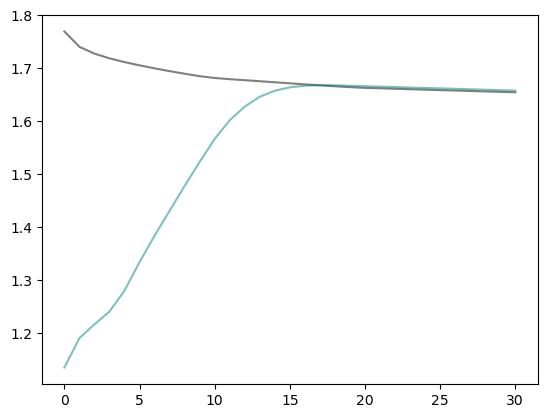

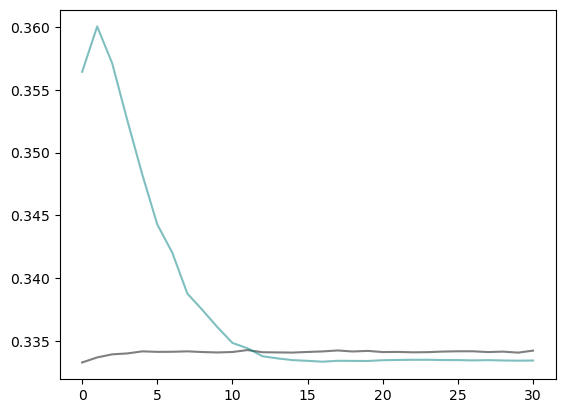

23/23 [==============================] - 1s 23ms/step


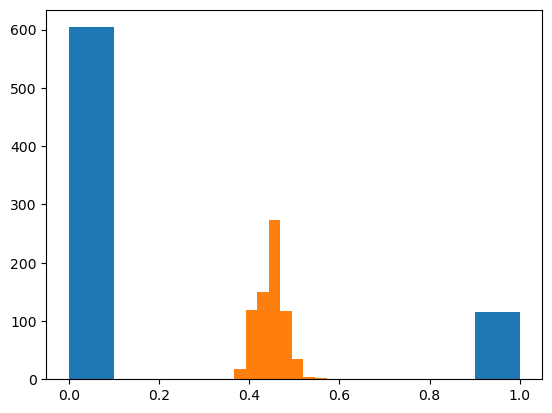

In [38]:
plt.plot(history.history['loss'],'-k',alpha = 0.5)
plt.plot(history.history['val_loss'],'teal',alpha = 0.5)
plt.show()

plt.plot(history.history['sparse_categorical_accuracy'],'-k',alpha = 0.5)
plt.plot(history.history['val_sparse_categorical_accuracy'],'teal',alpha = 0.5)
plt.show()

pred = unet.predict(Xtest).squeeze()
pred_class = np.argmax(pred,axis=-1)
pred_confvalues = np.max(pred,axis=-1)

plt.hist(pred_class[:,-5,10])
plt.hist(pred_confvalues[:,-5,10])
plt.show()

In [39]:
#unet.save('/glade/work/kjmayer/research/asd/saved_unets/unet_precip_northamerica_testbegin3yrs_constantsize.h5')

---
### VISUALIZE U-NET PREDICTION & COMPARE TO TRUTH & SMYLE
---

In [40]:
# ------ Specify image to plot -----
#   --> note that imshow plots the map upside down: origin='lower' inverts y so that the map is correct
i_plot = -60

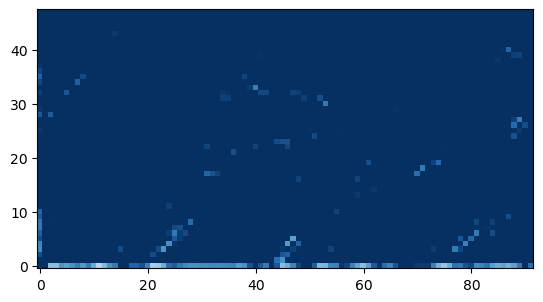

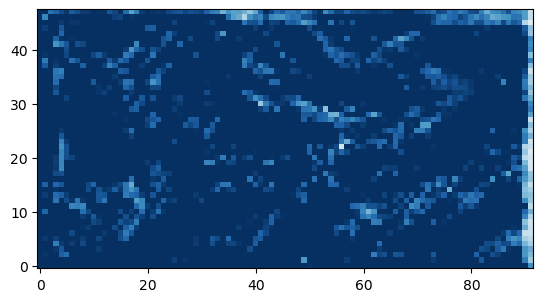

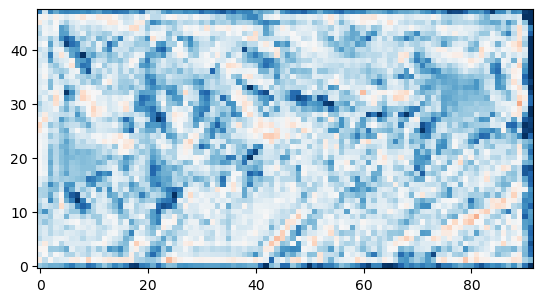

In [41]:
plt.imshow(pred[i_plot,:,:,0],origin='lower',vmin=0,vmax=.33,cmap='RdBu')
plt.show()
plt.imshow(pred[i_plot,:,:,1],origin='lower',vmin=0,vmax=.33,cmap='RdBu')
plt.show()
plt.imshow(pred[i_plot,:,:,2],origin='lower',vmin=0,vmax=.33,cmap='RdBu')
plt.show()

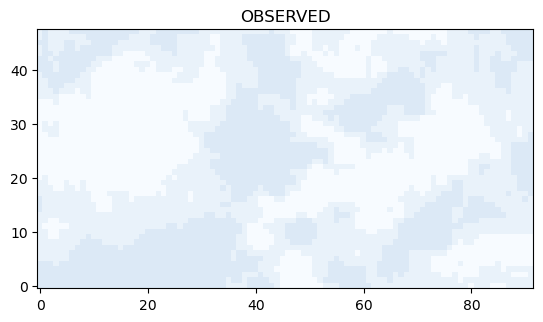

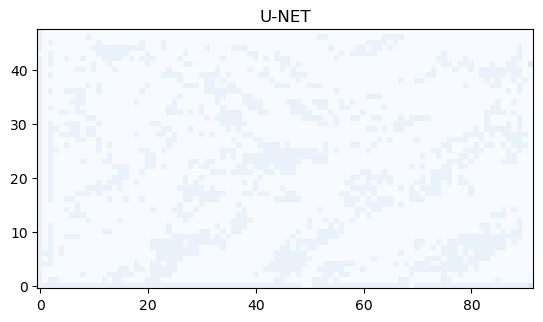

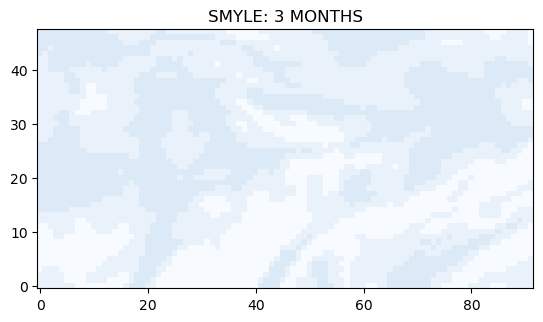

In [42]:
# ------- Plot Raw Ouput ------
plt.imshow(Ytest[i_plot], vmin=0, vmax=15, cmap='Blues',origin='lower')
plt.title('OBSERVED')
plt.show()

plt.imshow(pred_class[i_plot], vmin=0, vmax=15, cmap='Blues',origin='lower')
plt.title('U-NET')#: correlation = '+str(np.round(cc_unet,3)))
plt.show()

plt.imshow(Xtest[i_plot], vmin=0, vmax=15, cmap='Blues',origin='lower')
plt.title('SMYLE: 3 MONTHS')#: correlation = '+str(np.round(cc_org,3)))
plt.show()

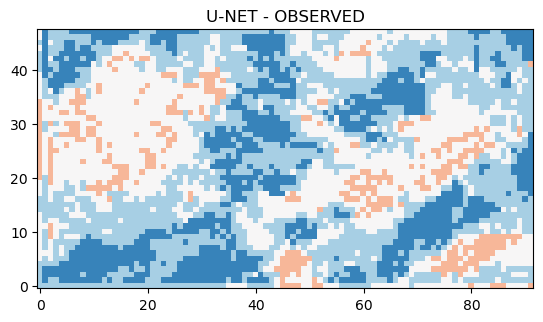

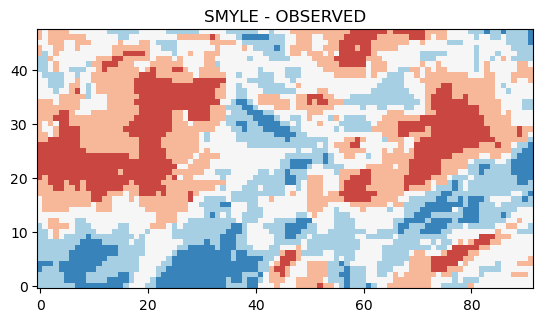

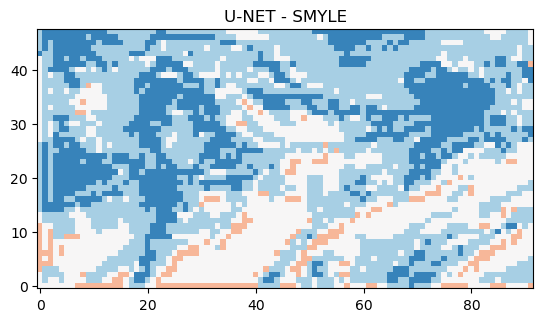

In [43]:
# ----- Difference Plots -----
plt.imshow(pred_class[i_plot] - Ytest[i_plot], vmin=-3, vmax=3, cmap='RdBu_r',origin='lower')
plt.title('U-NET - OBSERVED')
plt.show()

plt.imshow(Xtest[i_plot] - Ytest[i_plot], vmin=-3, vmax=3, cmap='RdBu_r',origin='lower')
plt.title('SMYLE - OBSERVED')
plt.show()

plt.imshow(pred_class[i_plot] - Xtest[i_plot], vmin=-3, vmax=3, cmap='RdBu_r',origin='lower')
plt.title('U-NET - SMYLE')
plt.show()

### Plot Accuracy for (non) confident 

In [44]:
conf_cutoff = np.percentile(pred_confvalues, q = 80, axis=0)

pred_confvalues_reshape = pred_confvalues.reshape((np.shape(pred_confvalues)[0],np.shape(pred_confvalues)[1]*np.shape(pred_confvalues)[2]))
iconf = np.where(pred_confvalues_reshape >= conf_cutoff.flatten()).reshape(np.shape(pred_confvalues))
pred_class_conf = pred_class[iconf]
Ytest_conf = Ytest[iconf]

# true = Ytest
acc = (xr.where(pred_class == Ytest, x = 1, y = 0).sum(axis=0)/Xtest.shape[0]) * 100
acc_conf = (xr.where(pred_class_conf == Ytest_conf, x = 1, y = 0).sum(axis=0)/Xtest[iconf].shape[0]) * 100

AttributeError: 'tuple' object has no attribute 'reshape'

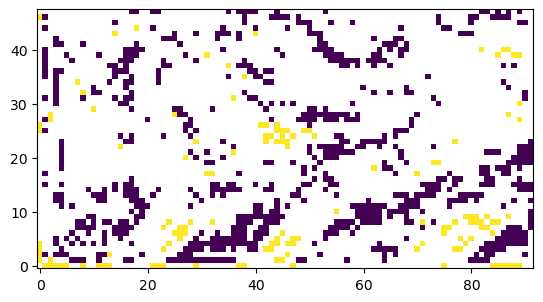

In [45]:
plt.imshow(xr.where(pred_confvalues >= conf_cutoff, x = pred_class, y = np.nan)[-60],origin='lower')